## Final Project Submission

Please fill out:
* Student name: **John ODonnell**
* Student pace: **self paced** 
* Scheduled project review date/time: **10:00 am June 10th 2021**
* Instructor name: **Jeff Herman**
* Blog post URL: https://johnodonnell123.github.io/pages/page_blogpost_2.html


## Approach
- I began with a normal workflow in which I cleaned the data, explored it visually, performed some feature engineering, transformed and scaled values, then created a regression model. After doing this I was curious how each of these steps impacted the models performance and inference, so I decided to turn each of these steps into functions. I then iteratively built models either omitting or changing the parameters to each function to quantify the impact of each 

## Outline

- #### **Part 1: Cleaning and EDA**
    - Handle duplicates, NaN's, dtypes, and minimal feature engineering
    - Each feature's distribution is viewed as its relationship with our dependent varaible
- #### **Part 2: Questions**
    - 3 Questions are proposed with visuals to answer 
- #### **Part 3: Create an iterative model:**
    - Create functions that will:
        - Feature Engineer
        - Log Transform Features
        - Standardize Features
        - Create Linear Model
    - Run the model using all possible combinations
- #### **Part 4: Model Assessment**
    - Determine which model was the most successful in prediction
    - Determine which methods were most impactful on model performance (feature engineering vs transforming etc)

##### 
##### <center>-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------</center>
##### 

# <center><u> Part 1: Data Cleaning </u></center>

### Import Packages

In [27]:
import warnings
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
import plotly.graph_objects as go
warnings.simplefilter(action='ignore')
pd.set_option('display.max_columns', None)
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
pd.set_option('display.float_format', lambda x: '%.4f' % x)

### Import Data and Inspect

In [28]:
# Import .csv file into DataFrame
df = pd.read_csv(r'kc_house_data.csv')

# Rename columns and index for interpretability
new_names = {'id':'sale_id','date':'sale_date','price':'sale_price','view':'has_been_viewed','sqft_above':'sqft_no_basement',
             'sqft_living15':'sqft_living_15_nn','sqft_lot15':'sqft_lot_15_nn'}

df.rename(columns = new_names, inplace=True)
df.index.name = 'unique_id'

# View sample of DataFrame
display(df.shape)
df.sample(2)

(21597, 21)

,sale_id,sale_date,sale_price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,has_been_viewed,condition,grade,sqft_no_basement,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living_15_nn,sqft_lot_15_nn
unique_id,,,,,,,,,,,,,,,,,,,,,
16061,9268200285,7/3/2014,370000.0000,2,1.0000,860,5040,1.0000,0.0000,0.0000,3,7,860,?,1956,0.0000,98117,47.6977,-122.3650,1570,5040
18737,8956000100,11/21/2014,695000.0000,3,3.5000,2630,4713,2.0000,0.0000,2.0000,3,9,2030,600.0,2008,0.0000,98027,47.5473,-122.0160,2450,4187


### Check for Duplicates
##### The `sale_id` column does have duplicates, but they appear to be unique sales for the same house

In [29]:
#df['sale_id'].duplicated().value_counts()
df.duplicated().value_counts()

False    21597
dtype: int64

### View Missing Data

In [30]:
# df.isna().sum()
# df.isna().mean()*100 

### The following columns are missing data
- **`waterfront`** : Missing 2376 values **(11%)**
- **`has_been_viewed`** : Missing 63 values **(<1%)**
- **`yr_renovated`** : Missing 3842 values **(17%)**
- **`sqft_basement`** : Has 454 value set to "?" **(2%)** and is the wrong dtype

#### Imputation vs Dropping: 
- Dropping data improved model performance vs. imputing with zero

In [31]:
# Replace "?" with nan
df['sqft_basement'].replace("?", np.nan, inplace = True)

# Drop NaNs
df = df.dropna()

## Inspect each column
- Ensure the dtype is correct
- View distribution and relationship with dependent variable

### Thoughts on Features:
- **`sale_date`** 
    - Convert to Pandas Datetime object
    - Distribution shows trend (less home sales in 2015)
        - Feature Engineer 
- **`sale_price`** 
    - Logarithmic, outliers
- **`bedrooms`** 
    - Logarithmic, one outlier
    - Non-linear relationship with sales_price
- **`bathrooms`** 
    - Few outliers
    - Positive correlation with sales_price on high end (probably worth keeping)
- **`sqft_living`** 
    - Logarithmic, outliers
    - Strong correlation with sales_price except for last data point
- **`sqft_lot`** 
    - Logarithmic, tons of outliers
- **`floors`**
    - OK
- **`has_been_viewed`**
    - OK
- **`condition`**
    - OK
- **`grade`**
    - OK
    - Strong correlation with sales price
- **`sqft_no_basement`** :
    - Logarithmic, outliers
- **`sqft_basement`**
    - Convert to float
    - Logarithmic, outliers
- **`yr_built`** 
    - OK
- **`yr_renovated`** 
    - Many zero values, may need to bump
    - Feature engineer binary?
    - Logarithmic
- **`zipcode`** 
    - Need to make categorical
    - Feature engineer
        - Calculate metrics by zip code
- **`lat/long`** 
    - Possible feature engineer
- **`sqft_living_15_nn`** 
    - Logarithmic, outliers
- **`sqft_lot_15_nn`** 
    - Logarithmic, outliers

### Typecast and extract year/month from **`sale_date`**

In [32]:
# Convert to dt
df['sale_date'] = pd.to_datetime(df['sale_date'])

# Get year
df['sale_year'] = df['sale_date'].dt.year

# Get month
df['sale_month'] = df['sale_date'].dt.month

### Typecast and engineer **`sqft_basement`**

In [33]:
# Typecast to float
df['sqft_basement'] = df['sqft_basement'].astype(float)

# Create new column and assign zero
df['has_basement'] = 0

# Denote all houses that have a sqft_basement > 0 as having a basement
df.loc[df['sqft_basement'] > 1,'has_basement'] = 1

# Drop old feature
df = df.drop(columns=['sqft_basement','sqft_no_basement'])

### Manipulate **`yr_renovated`**

In [34]:
# Create new column and assign zero
df['is_renovated'] = 0

# Denote all houses that have a renovation date as renovated
df.loc[df['yr_renovated'] > 1,'is_renovated'] = 1

# Drop old feature
df = df.drop(columns=['yr_renovated'])
df.sample(2)

,sale_id,sale_date,sale_price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,has_been_viewed,condition,grade,yr_built,zipcode,lat,long,sqft_living_15_nn,sqft_lot_15_nn,sale_year,sale_month,has_basement,is_renovated
unique_id,,,,,,,,,,,,,,,,,,,,,,
12030,6641020160,2014-05-06,513000.0000,4,2.5000,2000,5684,2.0000,0.0000,0.0000,3,8,1996,98028,47.7443,-122.2200,2210,7066,2014,5,0,0
9336,1328300040,2015-03-12,317500.0000,6,1.7500,2540,8400,1.0000,0.0000,0.0000,3,8,1977,98058,47.4414,-122.1290,1900,7695,2015,3,1,0


# Declare cleaned DataFrame for EDA

In [35]:
# Drop unwanted columns
df_cleaned = df.loc[:,~df.columns.str.contains('sale_date|sale_id')]
df_cleaned.sample()

,sale_price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,has_been_viewed,condition,grade,yr_built,zipcode,lat,long,sqft_living_15_nn,sqft_lot_15_nn,sale_year,sale_month,has_basement,is_renovated
unique_id,,,,,,,,,,,,,,,,,,,,
8668,496000.0000,2,1.0000,1420,4635,2.0000,0.0000,0.0000,4,7,1941,98115,47.6800,-122.3040,1810,4635,2014,12,0,1


##### 
##### <center>-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------</center>
##### 

# <center><u> Part 2: Questions </u></center>

## Question #1: Does the housing market have a seasonal trend in sale volume?

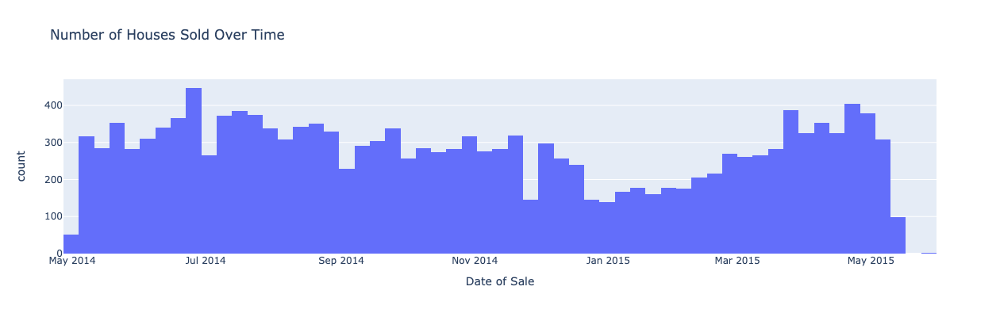

In [36]:
# Create figure
fig = px.histogram(df, 
                   x="sale_date", width=1000, height=400,
             title = "Number of Houses Sold Over Time",
             labels = {'sale_date':'Date of Sale'
                     })
fig.show()

### Interpretation:
- There does appear to be a trend in volume of houses sold through time
    - There is a gradual decline from July through January, then a recovery through May
    - Possible Interpretation: More homes may sell in the summer than in the winter, may also be macro-economic driven (need more data)
- It might be worth trying to feature engineer month and year from our data
    - These trends might hint at the supply/demand dynamic that can cause homes to sell above/below market value

##### 
##### <center>-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------</center>
##### 

## Question #2: Is there any one feature on a map that appears to drive prices higher?

In [37]:
import folium
import branca.colormap as cm

# Create map
map_visual = folium.Map(location=(df['lat'].mean(), df['long'].mean()), zoom_star = 9, width = 500, height = 500)

# Specify feature to color by
color_by = 'sale_price'

# Create color map
colormap = cm.LinearColormap(colors=['black','gray','green','yellow','orange','red'], vmin=200000, vmax= 1250000)

# Loop through each home in set, create circle, add to map.
for idx in df_cleaned.index:
    folium.Circle(
        location=[df_cleaned.loc[idx]['lat'], df_cleaned.loc[idx]['long']],
        radius = 8,
        fill = True,
        color = colormap(df_cleaned.loc[idx][color_by]),
        fill_opacity = 0.2
    ).add_to(map_visual)
    
# Add colorbar
colormap.caption = 'Sale Price'
map_visual.add_child(colormap)

# View
map_visual

### Interpretation:
- Houses that are closer to the two primary lakes (Washington and Sammamish) tend to have higher prices
- There are high value homes that lie away from these areas, but they are a minority

##### 
##### <center>-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------</center>
##### 

## Question #3: Do any of our variables show a non-linear relationship with **`sales_price`**?

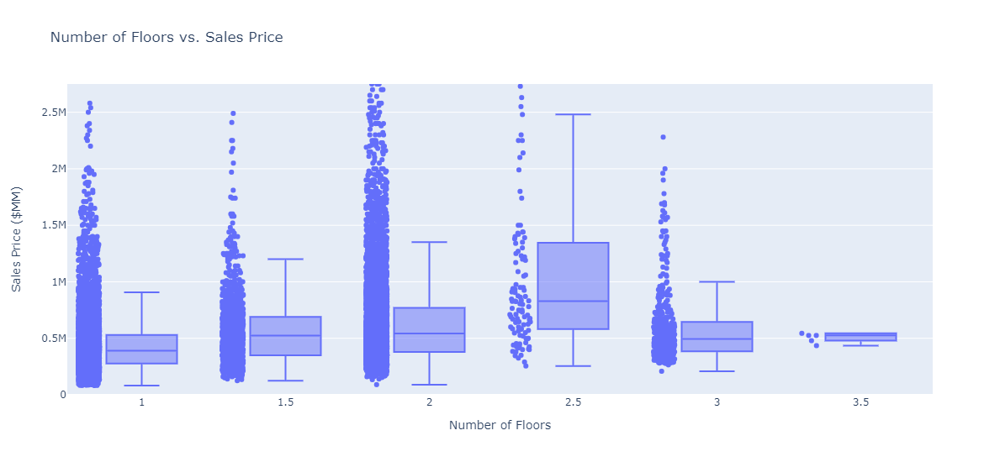

In [38]:
# Create Plot
fig = px.box(x=df['floors'],
             y=df['sale_price'],
             points = 'all',
             title = "Number of Floors vs. Sales Price",
             labels = {'x':'Number of Floors',
                     "y": "Sales Price ($MM)"
                     },
            height = 550,
            width = 800)

# Set y-limit
fig.update_layout(yaxis_range=[0,2750000])

fig.show()

### Interpretation:
- The amount of floors the home has appears to have an almost quadratic relationship with sales price
- It appears people value homes with 2-2.5 floors the most, adding additional floors beyond this threshold translates to *lower* prices
- Further Questions: Would our model perform better by dropping this varaible, or by removing data points with > 2.5 floors?

##### 
##### <center>-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------</center>
##### 

# <center><u> Part 3: Modelling </u></center>

## Define Function to feature engineer with **`zipcode`**
- This function does the following:
    - Creates a test/train split
    - Conditional upon an argument, it will perform feature engineering
        - A summary statistic is calculated for features grouped by zipcodes ***from the training data*** to prevent data leakage
    - It returns a DataFrame, and the train/test splits. The indexes of these splits are then used to define our splits for the final model

In [39]:
def feature_engineer(dataframe, engineer = 1):
    ''' 
    - Accepts a DataFrame object and a boolean value.
        - If the boolean value is 1:
            The function will create a train/test split, then perform feature engineering by calculating new features grouped by zipcode
        - If the boolean value is 0:
            The funciton will create a train/test split, it will not perform any feature engineering
    - Returns a DataFrame, and the train/test splits for the X and y
    '''
    
    if engineer == 1:
        
        # Create our X and y
        y0 = dataframe['sale_price']
        X0 = dataframe.drop(columns=['sale_price'])
        
        # Train/Test Split
        X_train0, X_test0, y_train0, y_test0 = train_test_split(X0, y0, test_size = 0.25, random_state = 42)

        # Create DataFrame of training data only
        train_data0 = pd.merge(X_train0, y_train0, left_index = True , right_index = True)

        # Create DataFrame to populate with GroupBy data
        zipcode_dataframe = pd.DataFrame()

        # Create a column in the new DataFrame for each feature grouped by zipcode
        # We are adding data to our primary DataFrame "dataframe", but only extracting data from our train set
        for col in ['sale_price','sqft_living','grade','yr_built','sqft_lot','condition','has_been_viewed','bedrooms','waterfront']:                
            zipcode_dataframe[f'median_{col}_in_zip'] = train_data0.groupby('zipcode')[col].median()

        # Add column to original DataFrame
        dataframe = dataframe.merge(zipcode_dataframe, left_on = 'zipcode', right_index = True)
                        
        return dataframe, X_train0, X_test0, y_train0, y_test0 
    
    else:
        
        # Perform same steps as above, omitting the feature engineering
        y0 = dataframe['sale_price']
        X0 = dataframe.drop(columns=['sale_price'])
        X_train0, X_test0, y_train0, y_test0 = train_test_split(X0, y0, test_size = 0.25, random_state = 42)

        train_data0 = pd.merge(X_train0, y_train0, left_index = True , right_index = True)

        return dataframe, X_train0, X_test0, y_train0, y_test0 

## Modelling
- Define function to test/train split and build linear regression model for a given DataFrame

In [46]:
def split_and_model(dataframe, X_train0, X_test0, y_train0, y_test0):
    ''' 
    - Accepts a DataFrame as well as train/test splits passed from a previously defined feature_engineering function:
    - This function defines the dependent variable, recreates train/test splits using the indexes of the provided splits,
      tests to ensure that they are the same, then creates a linear regression model from the data.
    - Returns a R-Squared, Adjusted R-Squared, and a dictionary with the features and coefficients
    '''
    # Define our dependent variable based on the provided columns in our DataFrame
    # Due to the iterative nature of the model building, sometimes our dependent varible will be log-transformed, sometimes not
    dep_var = 'sale_price' if 'sale_price_log' not in dataframe.columns else 'sale_price_log'
            
    # Define X and y
    y = dataframe[dep_var]
    X = dataframe.drop(columns=[dep_var])
    
    # Create splits using the indexes from the previously defined splits to ensure they are identical
    X_train = dataframe[dataframe.index.isin(X_train0.index)].drop(columns=[dep_var])
    X_test = dataframe[dataframe.index.isin(X_test0.index)].drop(columns=[dep_var])
    y_train = dataframe[dataframe.index.isin(y_train0.index)][dep_var]
    y_test = dataframe[dataframe.index.isin(y_test0.index)][dep_var]

    # Test to ensure that our splits are the same as before
    test1 = set(X_train.index) == set(X_train0.index)
    test2 = set(X_test.index) == set(X_test0.index)
    test3 = set(y_train.index) == set(y_train0.index)
    test4 = set(y_test.index) == set(y_test0.index)

    if np.all([test1, test2, test3, test4]):
        
        # Create linear model
        reg = LinearRegression().fit(X_train, y_train)

        # Evaluate Model
        # Calculate R-Squared
        R2 = round(reg.score(X_test, y_test), 3)

        # Calculate Adjusted R-Squared
        p = len(X.columns)
        n = len(X)
        adj_r2 = round(1-(1-R2)*(n-1)/(n-p-1),3)

        # Create dictionary of features and their coefficients
        results_dict = {X.columns[i]: abs(reg.coef_[i]) for i in range(len(X.columns))}
        results_dict = dict(sorted(results_dict.items(), key=lambda item: item[1], reverse=True))

        return R2, adj_r2, results_dict, reg
    
    else:
        print('ERROR WITH TRAIN TEST SPLIT')

## Log Transform Values
- Define a function to log transform a list of provided columns, then drop the non-transformed columns

In [47]:
def log_transform_and_drop(dataframe):
    ''' 
    - Accepts a DataFrame 
    - Log transforms predetermined columns in the DataFrame
    - Drop the columns that have transformed versions from the DataFrame
    - Returns the new DataFrame with transformed columns
    '''
    
    for col in ['sale_price','bedrooms','sqft_living','sqft_lot','condition','sqft_living_15_nn','sqft_lot_15_nn']:
        dataframe[f'{col}_log'] = np.log10(dataframe[col])
        
    dataframe = dataframe.drop(columns=[i for i in dataframe.columns if str(i) + '_log' in dataframe.columns])
    
    return dataframe

## Feature Scaling
- Define function to scale our features

In [49]:
def scale_features(dataframe):
    ''' 
    - Accepts a DataFrame 
    - Scales all of the data in the DataFrame using StandardScaler()
    - Returns the new DataFrame
    '''
    # Create Scalar
    scaler = StandardScaler()

    # Fit and transform the data, creating DataFrame with same index/columns as the original
    scaled_dataframe = pd.DataFrame(scaler.fit_transform(dataframe), index = dataframe.index, columns = dataframe.columns)
  
    return scaled_dataframe

## Iterate

In [50]:
# Create DataFrame to hold results
results_df = pd.DataFrame()

# Create variable to keep count of the number of iterations
count = 0

# Loop using a range of values to trim outliers in sqft_lot (feature with most extreme values)
for max_val in range(10000,500000,5000):
    
    df_clean_clip = df_cleaned[df_cleaned['sqft_lot'] < max_val] 
    
    for feature_engineering in [0,1]:
        
        df_clean_clip_engineered, X_train0, X_test0, y_train0, y_test0 = feature_engineer(df_clean_clip, feature_engineering)

        for standardized in [0,1]:
            
            for log in [0,1]:
                
                df_temp = df_clean_clip_engineered.copy()
                
                if log == 1:
                    df_temp = log_transform_and_drop(df_temp)

                if standardized == 1:
                    df_temp = scale_features(df_temp)                    

                # Train Test Split
                R2, adj_r2, results_dict, model = split_and_model(df_temp,X_train0, X_test0, y_train0, y_test0)
                
                # Add results to the results_df
                results_df.loc[count,'Adj_R2'] = adj_r2
                results_df.loc[count,'R2'] = R2
                results_df.loc[count,'Log_Transformed'] = log
                results_df.loc[count,'Standardized'] = standardized
                results_df.loc[count,'max_lot_size'] = max_val
                results_df.loc[count,'features_engineered'] = feature_engineering
                results_df.loc[count,'1st_important_feature'] = list(results_dict.keys())[0]
                results_df.loc[count,'2nd_important_feature'] = list(results_dict.keys())[1]
                results_df.loc[count,'3rd_important_feature'] = list(results_dict.keys())[2]

                count += 1
                
                if count % 250 == 0:
                    print(count)

results_df.sort_values('Adj_R2', ascending = False).head()

250
500
750


,Adj_R2,R2,Log_Transformed,Standardized,max_lot_size,features_engineered,1st_important_feature,2nd_important_feature,3rd_important_feature
207,0.8810,0.8810,1.0000,1.0000,135000.0000,1.0000,median_sale_price_in_zip,sqft_living_log,grade
205,0.8810,0.8810,1.0000,0.0000,135000.0000,1.0000,sqft_living_log,lat,condition_log
45,0.8800,0.8800,1.0000,0.0000,35000.0000,1.0000,sqft_living_log,lat,waterfront
47,0.8800,0.8800,1.0000,1.0000,35000.0000,1.0000,median_sale_price_in_zip,sqft_living_log,grade
63,0.8790,0.8790,1.0000,1.0000,45000.0000,1.0000,median_sale_price_in_zip,sqft_living_log,grade


##### 
##### <center>-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------</center>
##### 

# <center><u> Part 4: Model Evaluation </u></center>

### Does our Log Transform and/or Feature Engineering impact the Accuracy of the model?
- It does appear that both of these workflows had a substantial impact on our models predictions
    - Log Transformation improved performance by **~ 7%**
    - Feature Engineering improved performance by **~ 10%** 

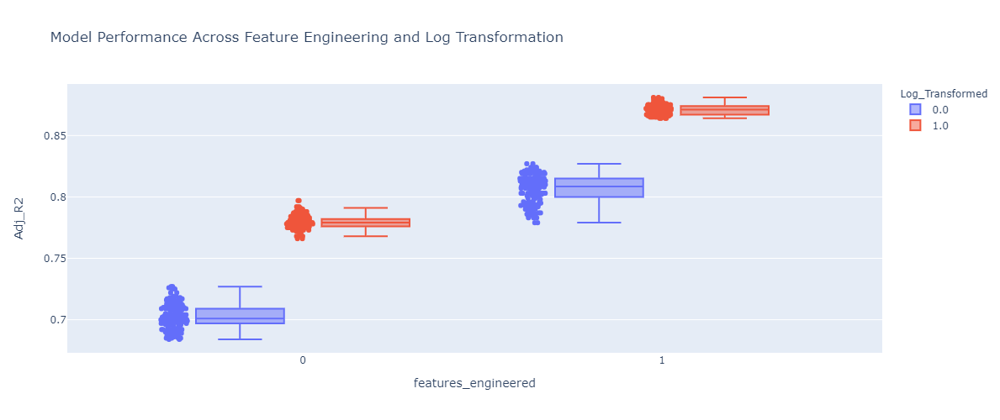

In [51]:
fig = px.box(results_df,
             x="features_engineered",
             y="Adj_R2",
             title = "Model Performance Across Feature Engineering and Log Transformation",
             color='Log_Transformed', points = 'all',
             height = 500, width = 700)
fig

### Does trimming outliers have a notable impact on our model?
- Trimming the outliers for `lot_size` does have a *marginal* impact on the model results
- As we start to trim the values the performance does creep higher, but the results become significantly less stable
    - The results are more stable for the log-transformed values
    - This leads me to believe these improvements are being driven by noise, not a real relationship
    - A case could be make to trim values at ~350,000 for a ~1% increase

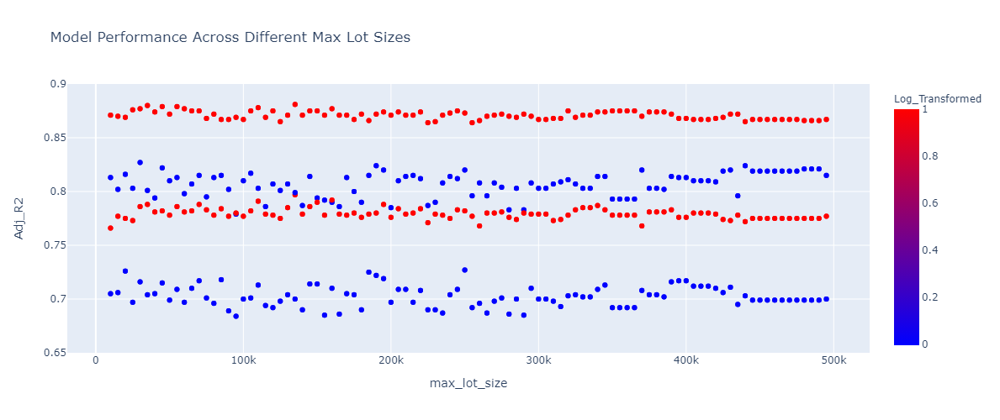

In [52]:
df_plot = results_df.copy()
df_plot.sort_values(by='max_lot_size', inplace=True)

fig = px.scatter(df_plot, 
             x = 'max_lot_size', 
             y = 'Adj_R2', 
             color='Log_Transformed',
             color_continuous_scale='bluered',
             title = "Model Performance Across Different Max Lot Sizes",
             width = 700,
             height = 500)

fig.update_layout(yaxis_range=[0.65,0.9])

fig.show()

### Scaling

- Scaling does not have an impact on the models accuracy
- It does have a huge impact on the coefficients of the model parameters
- This makes some features appear more/less impactful, and scaling the model is very important for interpretation

### Statsmodels Linear Regression

In [60]:
from statsmodels.formula.api import ols

# Define DataFrame
final_df = df_cleaned.copy()
# Feature Engineer
final_df, X_train0, X_test0, y_train0, y_test0 = feature_engineer(final_df,1)
# Log Transform
final_df = log_transform_and_drop(final_df)
# Scale
final_df = scale_features(final_df)
# Drop columns with low p-value (iterative)
final_df = final_df.drop(columns=['zipcode','floors'])

# Define dependent / indepenent variables 
outcome = 'sale_price_log'
x_cols = final_df.drop(columns=[outcome]).columns

# String together predictors
predictors = '+'.join(x_cols)

# Define formula
formula = outcome + '~' + predictors

# Create model
model = ols(formula = formula, data = final_df).fit()

# View Results
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         sale_price_log   R-squared:                       0.866
Model:                            OLS   Adj. R-squared:                  0.865
Method:                 Least Squares   F-statistic:                     4132.
Date:                Tue, 15 Jun 2021   Prob (F-statistic):               0.00
Time:                        06:38:10   Log-Likelihood:                -6413.1
No. Observations:               15429   AIC:                         1.288e+04
Df Residuals:                   15404   BIC:                         1.307e+04
Df Model:                          24                                         
Covariance Type:            nonrobust                                         
=================================================================================================
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
Intercept                     -2.956e-15      0.003     -1e-12      1.000      -0.006       0.006
bathrooms                         0.0701      0.005     13.344      0.000       0.060       0.080
waterfront                        0.0773      0.003     23.663      0.000       0.071       0.084
has_been_viewed                   0.0906      0.004     25.849      0.000       0.084       0.097
grade                             0.2417      0.005     44.723      0.000       0.231       0.252
yr_built                         -0.0432      0.005     -8.767      0.000      -0.053      -0.034
lat                               0.1835      0.004     49.135      0.000       0.176       0.191
long                              0.0615      0.005     12.424      0.000       0.052       0.071
sale_year                         0.0606      0.005     12.775      0.000       0.051       0.070
sale_month                        0.0153      0.005      3.233      0.001       0.006       0.025
has_basement                     -0.0305      0.003     -8.968      0.000      -0.037      -0.024
is_renovated                      0.0237      0.003      7.492      0.000       0.017       0.030
median_sale_price_in_zip          0.4726      0.007     66.713      0.000       0.459       0.486
median_sqft_living_in_zip        -0.2401      0.010    -22.917      0.000      -0.261      -0.220
median_grade_in_zip               0.0253      0.007      3.569      0.000       0.011       0.039
median_yr_built_in_zip           -0.0687      0.008     -8.705      0.000      -0.084      -0.053
median_sqft_lot_in_zip           -0.0383      0.003    -10.951      0.000      -0.045      -0.031
median_condition_in_zip           0.0132      0.003      3.812      0.000       0.006       0.020
median_has_been_viewed_in_zip  2.779e-17   1.77e-18     15.735      0.000    2.43e-17    3.13e-17
median_bedrooms_in_zip            0.0344      0.005      6.998      0.000       0.025       0.044
median_waterfront_in_zip       5.957e-17   4.15e-18     14.355      0.000    5.14e-17    6.77e-17
bedrooms_log                     -0.0418      0.004    -10.304      0.000      -0.050      -0.034
sqft_living_log                   0.3193      0.007     44.845      0.000       0.305       0.333
sqft_lot_log                      0.1013      0.008     13.126      0.000       0.086       0.116
condition_log                     0.0650      0.003     19.631      0.000       0.059       0.072
sqft_living_15_nn_log             0.1030      0.005     19.672      0.000       0.093       0.113
sqft_lot_15_nn_log               -0.0493      0.008     -6.476      0.000      -0.064      -0.034
==============================================================================
Omnibus:                     1059.593   Durbin-Watson:          

### Create dictionary to bind features to coefficients and sort

In [58]:
# Create dictionary with features for keys and coefficients for values
results_dict = {x_cols[i]: model.params[i] for i in range(len(x_cols))}
# Sort dictionary by absolute value of coefficient
results_dict = dict(sorted(results_dict.items(), key=lambda item: abs(item[1]),reverse=True))

### View Feature Importance

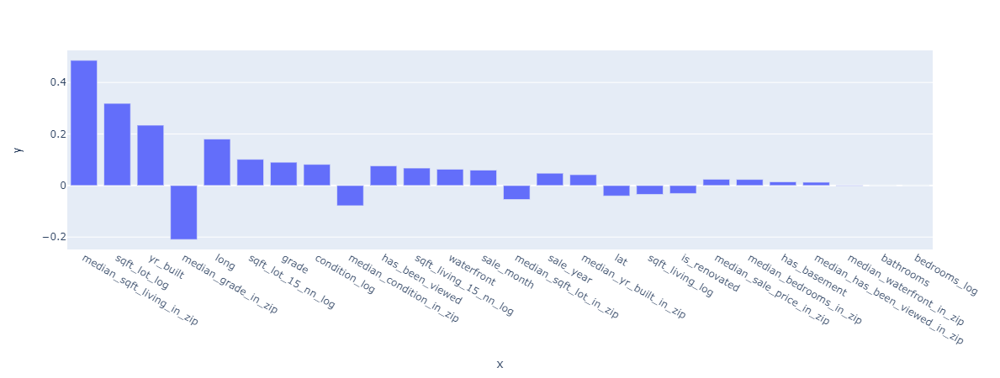

In [59]:
fig = px.bar(x=results_dict.keys(), y=results_dict.values())
fig.show()

### Effect Plot
- Weights multiplied by features

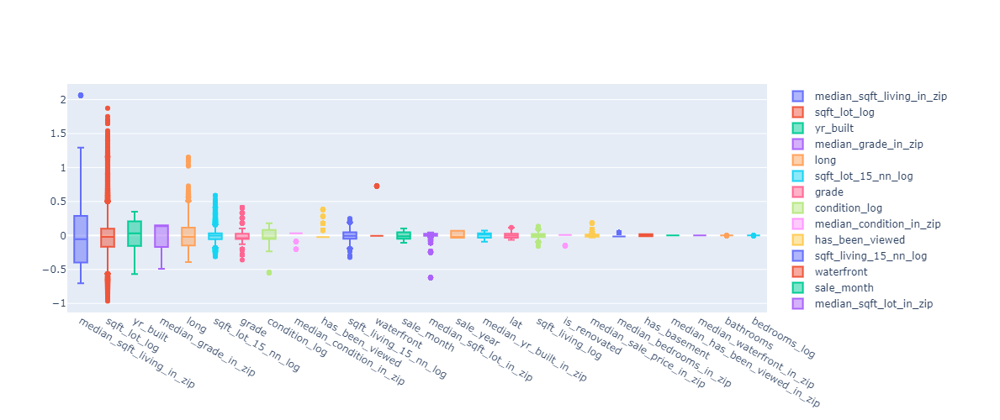

In [61]:
fig = go.Figure(layout=go.Layout(height=500, width=1000))

for feature, coef in results_dict.items():
    fig.add_trace(
        go.Box(
               y=final_df[feature]*coef,
               name=feature))

fig.show()

##### 
##### <center>-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------</center>
##### 

## Model Explanation

- The model created in this notebook has the ability to predict housing price with ~ 88% accuracy. It has interpreted that while certain properties of the home such as the age, size, and quality are indeed important, the quality and price of homes in the same general location are very important as well. This is intuitive to understand, as nicer homes are likely to be worth less when surrounded by homes that are of a lower quality. It also yields insight into the mentality of the buyer, people don't feel as if they are just purchasing homes, but communities. 

### Coefficient #1: **`median_sqft_living_in_zip`**
- This was interpreted to be the most important feature and appears to have a *positive* impact on the price of a home
- If a house is in a zipcode that doesn't have any extremely small homes, it tends to have a higher value

### Coefficient #2: **`sqft_lot_log`**
- This was interpreted to be the second most important feature and appears to have a *positive* impact on the price of a home
- It is interesting that the lot size of the property is a better predictor of price than the square footage of the house

### Coefficient #3: **`yr_built`**
- This was interpreted to be the third most important feature and appears to have a *positive* impact on the price of a home
- This is intuitive, newer houses appear to be worth more
- When scatterplotting the year built vs sales price there does not appear to be a strong relationship
    - The model was able to untangle the complex relationships and determine that newer houses are priced higher

##### 
##### <center>-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------</center>
##### 

# Further Insight: Possible Opporunity
- Here the "best" model is recreated, and houses who appear to be severly undervalued are identified

### Re-create "best" model calculate predictions, actuals, residuals

In [62]:
df_clean_clip = df_cleaned[df_cleaned['sqft_lot'] < 350000]
df_clean_clip_engineered, X_train0, X_test0, y_train0, y_test0 = feature_engineer(df_clean_clip, 1)
df_temp = log_transform_and_drop(df_clean_clip_engineered)
R2, adj_r2, results_dict, model = split_and_model(df_temp,X_train0, X_test0, y_train0, y_test0)
X = df_temp.drop(columns=['sale_price_log'])
y = df_temp['sale_price_log']
comparison_df = X.copy()
comparison_df['Prediction'] = model.predict(comparison_df)
comparison_df['Actual'] = y
comparison_df['Residual'] = comparison_df['Prediction'] - comparison_df['Actual']

### Plot predictions vs actuals

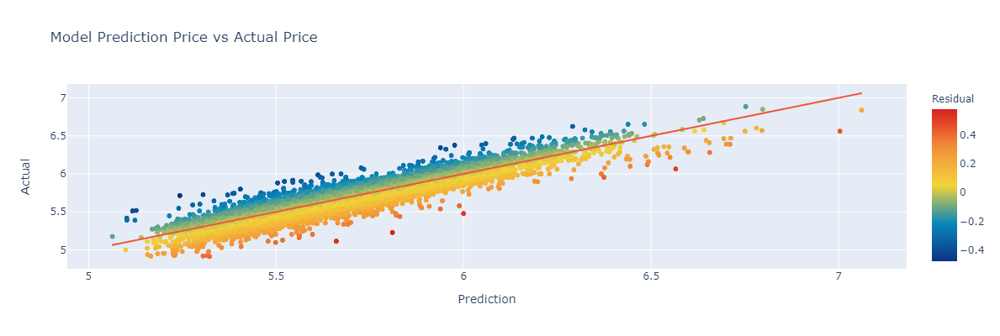

In [63]:
fig = px.scatter(comparison_df, 
                 x='Prediction', 
                 y='Actual', 
                 trendline="ols",
                 color='Residual',
                 color_continuous_scale='portland',
                 title='Model Prediction Price vs Actual Price',
                 height = 400,
                 width = 700
                )
fig.show()

### Identify undervalued homes after visual inspection

In [64]:
df_opportunity = comparison_df[comparison_df['Residual'] > 0.20]
display(df_opportunity.shape)
df_opportunity.head()

(267, 31)

,bathrooms,floors,waterfront,has_been_viewed,grade,yr_built,zipcode,lat,long,sale_year,sale_month,has_basement,is_renovated,median_sale_price_in_zip,median_sqft_living_in_zip,median_grade_in_zip,median_yr_built_in_zip,median_sqft_lot_in_zip,median_condition_in_zip,median_has_been_viewed_in_zip,median_bedrooms_in_zip,median_waterfront_in_zip,bedrooms_log,sqft_living_log,sqft_lot_log,condition_log,sqft_living_15_nn_log,sqft_lot_15_nn_log,Prediction,Actual,Residual
unique_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
3194,1.7500,1.0000,0.0000,0.0000,8,1952,98125,47.7070,-122.3160,2015,3,1,0,425000.0000,1560.0000,7,1954.0000,7415.5000,3.0000,0.0000,3.0000,0.0000,0.6021,3.4786,4.0977,0.4771,3.3096,3.8785,5.8159,5.6031,0.2128
4860,1.0000,1.0000,0.0000,0.0000,7,1947,98125,47.7149,-122.3180,2015,2,0,0,425000.0000,1560.0000,7,1954.0000,7415.5000,3.0000,0.0000,3.0000,0.0000,0.3010,3.0645,3.8395,0.4771,3.0492,3.8419,5.5699,5.2430,0.3269
5989,2.0000,1.0000,0.0000,0.0000,8,1962,98125,47.7058,-122.3150,2014,10,1,0,425000.0000,1560.0000,7,1954.0000,7415.5000,3.0000,0.0000,3.0000,0.0000,0.4771,3.4771,4.2504,0.4771,3.3802,3.9191,5.8214,5.6021,0.2193
7560,1.5000,1.0000,0.0000,0.0000,7,1953,98125,47.7276,-122.3120,2014,5,0,0,425000.0000,1560.0000,7,1954.0000,7415.5000,3.0000,0.0000,3.0000,0.0000,0.4771,3.1761,3.8019,0.6990,3.1523,3.8019,5.6471,5.4314,0.2158
13925,2.2500,1.5000,0.0000,0.0000,8,1963,98125,47.7239,-122.3130,2014,7,1,0,425000.0000,1560.0000,7,1954.0000,7415.5000,3.0000,0.0000,3.0000,0.0000,0.4771,3.4698,3.9050,0.4771,3.3139,3.8573,5.7985,5.5871,0.2113


### Map Residuals

In [65]:
import folium
import branca.colormap as cm

# Create map
map_visual = folium.Map(location=(df_opportunity['lat'].mean(), df_opportunity['long'].mean()), zoom_star = 9, width = 500, height = 500)

# Specify feature to color by
color_by = 'Residual'

# Create color map
colormap = cm.LinearColormap(colors=['black','gray','green','yellow','orange','red'], vmin=.15, vmax= .4)

# Loop through each home in set, create circle, add to map.
for idx in df_opportunity.index:
    folium.Circle(
        location=[df_opportunity.loc[idx]['lat'], df_opportunity.loc[idx]['long']],
        radius = 100,
        fill=True,
        color = colormap(df_opportunity.loc[idx][color_by]),
    
    ).add_to(map_visual)
    
# Add colorbar
colormap.caption = 'Sale Price'
map_visual.add_child(colormap)

# View
map_visual